<h1 align="center"><strong><font size="6"> The Soccer-Factor-Model <br> Identifying a Soccer-Player's Skill/Ability via Bayesian Logistic Regression </h1></strong></font>

## Pre-Game Ramblings

### What's the Soccer-Factor-Model all about?

#### The Inspiration

The Soccer-Factor-Model (SFM) is inspired by the academic literature on asset-pricing along the following lines:

> 1. Factor Models à la [Fama & French](https://onlinelibrary.wiley.com/doi/full/10.1111/j.1540-6261.1992.tb04398.x) use "factors" to explain the cross-section of stock returns. <br>
 --> **here**: we use "Team-Factors" to explain away the role of the team's strength in making a given player $i$ score a goal.

> 2. There is some literature on the skill of investment fund managers that works in a similar way: "explain away" that proportion of a fund's returns that is related to economic fundamentals (e.g. [Coggin, Fabozzi, Rahman (1993)](https://onlinelibrary.wiley.com/doi/10.1111/j.1540-6261.1993.tb04029.x); [Fama & French (2010)](https://onlinelibrary.wiley.com/doi/10.1111/j.1540-6261.2010.01598.x); [Berg & van Binsbergen (2015)](https://www.sciencedirect.com/science/article/pii/S0304405X15000628)):
\begin{align}
  r_{p,t} = \alpha_p + \sum^N_{n=1} \beta_n \, f_{n,t} + \varepsilon_{p,t}
\end{align} <br>
 where $r_{p,t}$ is portfolio $p$'s return in excess of the risk-free rate (e.g. short-term U.S. government bonds). $f_{n,t}$ measures the return that one could generate by following the strategy prescribed by **factor $n$**, and $\varepsilon_{p,t}$ is a random error that is usually assumed to be mean zero. <br> The parameter of interest here is $\mathbf{\alpha_p}$. It is that part of a portfolio's conditional mean, that is not to be explained by the factors $f_{1,t},...,f_{N,t}$, and is a measure of the portfolio manager's **skill/ability**. Said differently: it quantifies the manager's ability to generate returns **beyond** the return you would have received by just following the investment strategy dictated by the factors.

#### From Asset-Pricing to Soccer

In our case, the "dependent variable"/"label"/"outcome variable" ($y_{i,s,m}$) will be a binary indicator, telling us whether player $i$ has scored a goal (or not) in season $s$ in match $m$:

\begin{align}
        y_{i,s,m} = \left\{
        \begin{array}{cl}
        0 & \textbf{not} \text{ scored} \\
        1 & \text{scored}
        \end{array}
        \right.
\end{align}

> *Sidenote*: This binary classification exercise is just a way to keep things simple. One may also want to predict the *number* of goals in a given match, which would make it for a multiclass extension.

The SFM is then set-up as follows:

\begin{align}
     p_{i,s,m} \equiv   P\left(y_{i,s,m} = 1 | \mathbf{x}_{i,s,m-1}, \alpha_i, \beta \right) = \sigma \left(\alpha_{i} + \mathbf{x}_{i,s,m-1} \, \mathbf{\beta} \right) \qquad \left( M.1 \right)
\end{align}

where:

> - $p_{i,s,m}$: &ensp;&ensp;&emsp; The probability of player $i$ scoring a goal in season $s$ in match $m$ *conditional* on $\mathbf{x}_{i,s,m-1}$, $\alpha_i$, and $\beta \;$ ;

> - $\mathbf{x}_{i,s,m-1}$: &emsp; A $\; 1 \times N$ vector of *factors* that are intended to resemble the imbalance between player $i$'s team and the <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; opponent-team. The subscript $m-1$ signals that these *factors* only contain information about the teams' <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; differences that prevail **before** the referee blows the whistle to start off match $m$ ! <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; Again, to be clear, these *factors* are intended to explain that fraction of $p_{i,s,m}$ that is due to the difference in the <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; strength  of player $i$'s team and the opponent-team;

> - $\beta$: &ensp;&ensp;&ensp;&ensp;&ensp;&emsp; The sensitivity of $p_{i,s,m}$ to the factors $\mathbf{x}_{i,s,m} \;$;

> - $\alpha_i$: &ensp;&ensp;&ensp;&ensp;&ensp; Our main parameter of interest as it captures that fraction of $p_{i,s,m}$ that is attributed to player $i$'s skill/ability only! <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; (Yes, later on, this parameter will carry a subscript $s$, $\alpha_{i,s} \;$, allowing a player's skill/ability to vary across seasons);

> - $\sigma \left(\cdot\right)$: &ensp;&ensp;&emsp; The $\mathtt{sigmoid}$ function, which transforms the predictions of the linear model $\alpha_i + \mathbf{X}_i \, \mathbf{\beta}$ into a number that <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; ranges between zero and one, such that $p_{i,s,m} \in \left[0;1\right]$.

Just for notational convenience, we will re-write Equation ($M.1$) to get rid off the subscripts $s$ and $m$:

\begin{align}
     p_{i} \equiv   P\left(Y_{i} = 1 | \mathbf{X}_{i}, \alpha_i, \beta \right) = \sigma \left(\alpha_{i} + \mathbf{X}_{i} \, \mathbf{\beta} \right) \qquad \left( 1 \right )
\end{align}

where now:

> - $Y_{i}$: &ensp;&ensp;&ensp;&ensp;&ensp; A $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times 1$ vector of zeros and ones,
> - $\mathbf{X}_i$: &ensp;&ensp;&ensp;&ensp;&emsp; A $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times N$ matrix of *factors*
> > where
> > - $S_i$:  &ensp;&ensp;&ensp; The total number of seasons player $i$ has played,
> > - $M_{i,s}$: &ensp; The total number of matches played by player $i$ in season $s$.
> - $p_{i}$: &ensp;&ensp;&ensp;&ensp;&ensp; With a slight abuse of notation, a $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times 1$ vector of probabilities, with $p_{i} \in \left[0;1\right]$.

<br>

<font color='darkred'>**IMPORTANT**</font>: &emsp; The explanatory variables (*factors*, $\mathbf{X}_i$) describe the *state* that had persisted **before** a given match $m$ was played.  <br>
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; E.g., when we observe $y_{i,s,m}$, the *factors* will only capture information that was available to us **prior to** match $m$! <br>
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; Therefore, we will have the following mapping: $y_{i,s,m} \rightarrow \mathbf{x}_{i,s,m-1}$.

### Factors: The Heart of the SFM

Factors are intended to help us understand which part of $p_i$ is due to the strength of the **team** ( $\mathbf{X}_i \, \mathbf{\beta}$ ) that player $i$ is playing for, and which proportion of $p_i$ is due to player $i$'s **own** ($\alpha_i$) skill/ability. In that sense, $\alpha_i$ is our main parameter of interest as it gives us a measure of the **skill/ability** of player $i$ to score a goal.

<font color='darkred'>**NOTE**</font>: &emsp; Hard-core finance academics might be outraged with me making a comparison between the SFM-factors ($\mathbf{x}_{i,s,m-1}$) that I introduce below, and the **true** asset-pricing factors ($f_t$) mentioned above.
One reason is that the SFM-factors carry an additional subscript $i$, which indicates that these factors vary across teams or even across players. In contrast, the traditional asset-pricing factors are only varying across time, but are *invariant* across entities.

### Factor Engineering

The number of *factors* we can build and their informative value, depends obviously on the data that is available to us. For the following exercise, I depend on publicly available data free of charge. That is already a limitation for producing a meaningful model.

However, I guess I found a decent dataset, which I pulled from [#Kaggle](https://www.kaggle.com/datasets/marclamyhshshs/premier-league-games?select=clean_players_info.csv).
All credits for that dataset go to [Marc Lamyhshshs](https://www.kaggle.com/marclamyhshshs).
It comprises all Premier League matches since 1992, which allows us to look at some very, very, very interesting players!

The amount of data is surely impressive! This allows us to create some interesting *factors*.

To showcase how SFM works, I chose to construct the following ones:

- `goalsscored_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The current difference of *goals scored* by player $i$'s team and the opponent-team
- `goalsscored_rank_team`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The current ranking of player $i$'s team in *goals scored*
- `goalsscored_rank_team_wo_player`: &emsp; The current ranking of player $i$'s team in *goals scored*, not accounting for <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; the number of goals scored by player $i$
- `goalsconceded_rank_opp`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp; The current ranking of the opponent-team in *goals conceded*
- `points_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; The difference in points of the player's team and the opponent
- `goal_balance_team`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between *goals scored* and *goals conceded* of the team which <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; our player of interest is playing for
- `goal_balance_opp`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between *goals scored* and *goals conceded* of the opponent-team which <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; our player of interest is playing against in match $m$
- `goal_balance_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between `goal_balance_team` and `goal_balance_opp`

Throughout the notebook, I attached some questions about whether a given factor is actually related to team-effort or actually an indication of a player's strength. If the latter were true, we should exclude that particular factor as our model would be mis-specified! Or we would just hope that the posterior of the corresponding loading is centered around zero with only little variance...

<font color='darkred'>**Lastly:**</font> This list of factors is by no means comprehensive and much more creative minds might already have thought of many more fancy factors to build from the underlying data.
Feel free to build your own factors! Data on `shots_home` and `shots_away` sound to have potential to form other interesting explanatory variables that I haven't included yet!

## TODO

* Factors
    * We use a different "center" variable than the original paper. It doesn't seem to sample too well.
    * We could also try to use other variables for the factors.
* Data
    * Which players to run the whole model on.
    * Which players to select as the "elite level players"
    * Which players to select as the "replacement level players"

## Data preparation

In [1]:
from typing import List, Union

import arviz as az
import matplotlib.lines as mlines
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import preliz as pz
import pymc as pm
import pytensor.tensor as pt
import seaborn as sns
import xarray as xr
from matplotlib.lines import Line2D
from scipy.stats import norm
from sklearn.preprocessing import StandardScaler

pm.__version__

'5.22.0'

In [2]:
az.style.use("arviz-whitegrid")
plt.rcParams["figure.figsize"] = [12, 5]
%config InlineBackend.figure_format = 'retina'
seed = sum(map(ord, "sfm"))
rng = np.random.default_rng(seed)

In [3]:
factors_numeric = ["points_diff"]
other_factors = ["center", "home_pitch"]
factors = other_factors + factors_numeric

In [16]:
complete_data = pd.read_csv("../data-download/data/j1l_transformed_small.csv")

complete_data["goal"] = complete_data["goal"].astype(int)
complete_data["goals_in_match"] = complete_data["goals_in_match"].astype(int)

complete_data["kick_off"] = pd.to_datetime(
    complete_data["kick_off"], yearfirst=True
).dt.normalize()

# compute season number for each player, ~maturity of player
complete_data["season_nbr"] = complete_data.groupby(["name_player"])[
    "season"
].transform(lambda x: x.factorize(sort=True)[0])

# --- Compute share of games played as center or winger
complete_data["share_center"] = complete_data["N_games_center"] / complete_data[
    ["N_games_other", "N_games_center"]
].sum(axis=1)
# --- Unfortunately: drop NAs...
complete_data = complete_data.dropna(subset="share_center").reset_index(drop=True)

# idiosyncracy: remove Henry's last games in 2011/12
complete_data = complete_data[
    ~(
        (complete_data["name_player"] == "thierry-henry")
        & (complete_data["season"] == "2011/12")
    )
]

complete_data = complete_data.sort_values(["name_player", "kick_off"]).reset_index(
    drop=True
)
complete_data

,id_match,gameday,kick_off,name_league,season,name_player,goals_in_match,goal,home_pitch,name_team,name_opp,points_team,points_opp,points_diff,is_center,id_league,N_games_center,N_games_other,share_center,season_nbr
0,3a27486a,16,2021-05-26,J1 League,2021,Adam Taggart,0,0,0,Cerezo Osaka,Kashima Antlers,22,24,-2,True,J1,1,0,1.000000,0
1,ae0be445,17,2021-05-30,J1 League,2021,Adam Taggart,0,0,0,Cerezo Osaka,Vegalta Sendai,22,12,10,True,J1,2,0,1.000000,0
2,665454cf,23,2021-08-09,J1 League,2021,Adam Taggart,0,0,1,Cerezo Osaka,Vegalta Sendai,29,17,12,True,J1,3,0,1.000000,0
3,5aaea657,24,2021-08-15,J1 League,2021,Adam Taggart,1,1,0,Cerezo Osaka,Avispa Fukuoka,30,30,0,True,J1,4,0,1.000000,0
4,2b34ff20,25,2021-08-21,J1 League,2021,Adam Taggart,0,0,1,Cerezo Osaka,Yokohama FC,30,15,15,True,J1,5,0,1.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11103,1a73bc26,34,2024-10-18,J1 League,2024,Élber,0,0,1,Marinos,Albirex Niigata,44,39,5,True,J1,31,7,0.815789,3
11104,532b00b2,36,2024-11-09,J1 League,2024,Élber,0,0,0,Marinos,Sagan Tosu,46,29,17,True,J1,31,7,0.815789,3
11105,f482d425,29,2024-11-16,J1 League,2024,Élber,0,0,0,Marinos,Júbilo Iwata,41,28,13,True,J1,32,6,0.842105,3
11106,2e979457,37,2024-11-30,J1 League,2024,Élber,0,0,0,Marinos,Shonan Bellmare,49,45,4,False,J1,31,7,0.815789,3


In [17]:
players_ordered = complete_data["name_player"].sort_values().unique()
players_ordered.shape

(122,)

In [18]:
assert complete_data["name_player"].sort_values().unique().shape[0] == len(
    players_ordered
)

## Why an Ordered Categorical likelihood

Let's give a good look at the frequency of each count in the data. First in terms of probability:

In [19]:
complete_data["goals_in_match"].value_counts(normalize=True).round(4)

goals_in_match
0    0.8643
1    0.1188
2    0.0148
3    0.0019
4    0.0002
Name: proportion, dtype: float64

Then raw counts:

In [20]:
complete_data["goals_in_match"].value_counts()

goals_in_match
0    9601
1    1320
2     164
3      21
4       2
Name: count, dtype: int64

**The counts for 3+ goals are extremely rare compared to 0, 1 and 2 goals**. This means using a Poisson likelihood is not really appropriate, as the Poisson expects much higher counts on the right tail of the distribution.

In this case, it makes more sense to use a **Categorical likelihood with categories $[0, 1, 2, 3+]$**. That may sound counter-intuitive, as in theory the number of goals a player can score per game has no upper bound (hence the Poisson), but in practice, we see this number exceeds 2 less than 2% of the time.

As a result, lumping together any observations equal or higher to 3, and treating each of the 4 events as a distinct category, with its own probability of success, makes more sense and allows for a more sensical model.

In [21]:
# lump together values >= 3
complete_data["goals_cats"] = np.where(
    complete_data["goals_in_match"] >= 3, 3, complete_data["goals_in_match"]
)

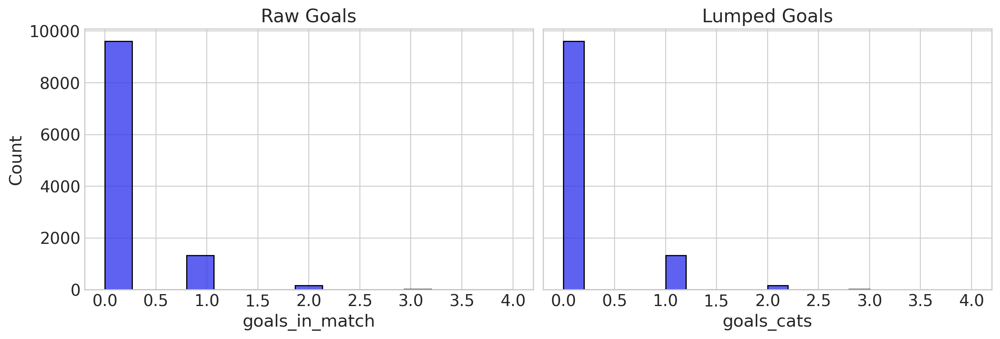

In [22]:
_, (left, right) = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(12, 4))
sns.histplot(complete_data, x="goals_in_match", ax=left)
left.set(title="Raw Goals")
sns.histplot(complete_data, x="goals_cats", ax=right)
right.set(title="Lumped Goals");

We can see that this virtually doesn't change anything, because the frequencies are so low for high counts. We can now implement the model.

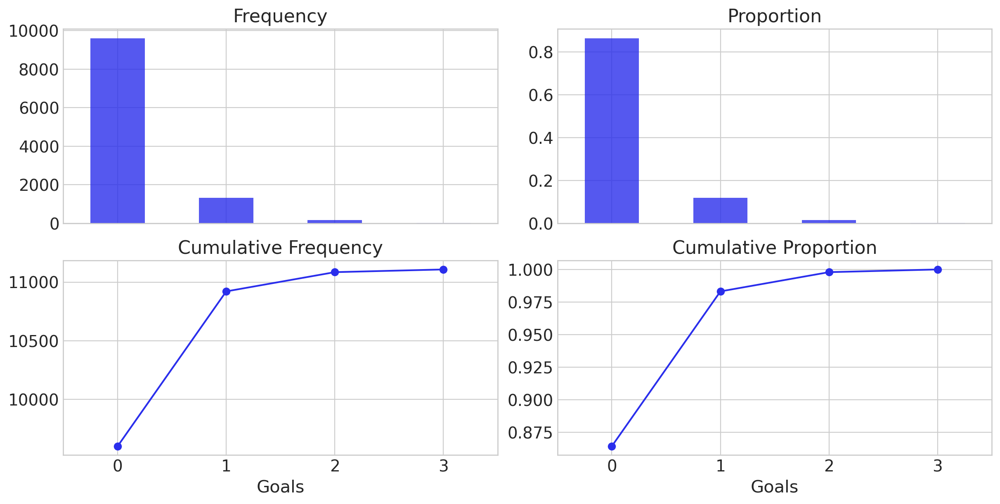

In [23]:
_, axes = plt.subplot_mosaic(
    [
        ["Frequency", "Proportion"],
        ["Cumulative Frequency", "Cumulative Proportion"],
    ],
    figsize=(12, 6),
    sharex=True,
    layout="constrained",
)

complete_data["goals_cats"].sort_values().value_counts(sort=False).plot(
    kind="bar", alpha=0.8, rot=0, ax=axes["Frequency"]
)
axes["Frequency"].set(xlabel="Goals", title="Frequency")

complete_data["goals_cats"].sort_values().value_counts(sort=False, normalize=True).plot(
    kind="bar", alpha=0.8, rot=0, ax=axes["Proportion"]
)
axes["Proportion"].set(xlabel="Goals", title="Proportion")

complete_data["goals_cats"].sort_values().value_counts(sort=False).cumsum().plot(
    marker="o", rot=0, ax=axes["Cumulative Frequency"]
)
axes["Cumulative Frequency"].set(xlabel="Goals", title="Cumulative Frequency")

complete_data["goals_cats"].sort_values().value_counts(
    sort=False, normalize=True
).cumsum().plot(marker="o", rot=0, ax=axes["Cumulative Proportion"])
axes["Cumulative Proportion"].set(xlabel="Goals", title="Cumulative Proportion");

In [24]:
complete_data["goals_cats"].sort_values().value_counts(sort=False).cumsum()

goals_cats
0     9601
1    10921
2    11085
3    11108
Name: count, dtype: int64

In [25]:
complete_data["goals_cats"].sort_values().value_counts(sort=False, normalize=True)

goals_cats
0    0.864332
1    0.118833
2    0.014764
3    0.002071
Name: proportion, dtype: float64

## Factor standardization

In [26]:
factors_numeric_train = complete_data[factors_numeric]

scaler = StandardScaler()
# Fit the scaler on the training data and transform the data
factors_numeric_sdz = pd.DataFrame(
    scaler.fit_transform(factors_numeric_train), columns=factors_numeric
)

# Add the non-numeric factor to the standardized DataFrame
factors_sdz = factors_numeric_sdz.copy()
factors_sdz[other_factors] = complete_data[["share_center", "home_pitch"]]

# make sure the order is the same as the PyMC coords later on
factors_sdz = factors_sdz[factors]

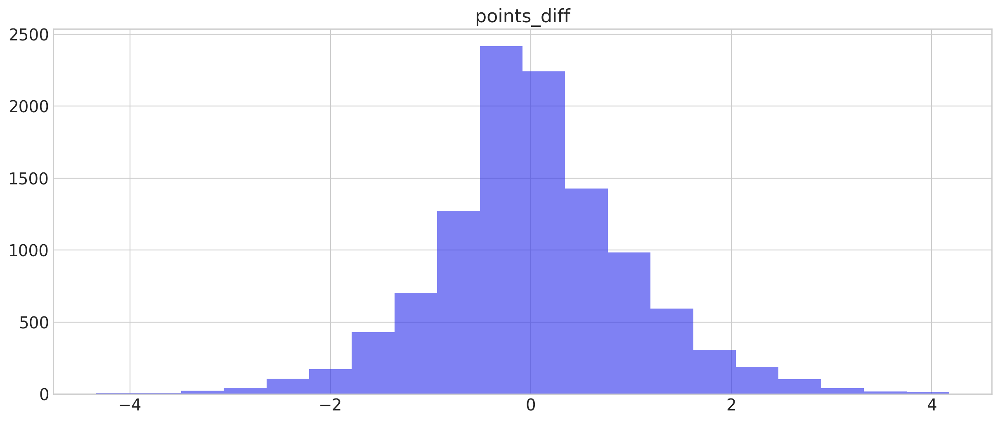

In [27]:
factors_numeric_sdz.hist(alpha=0.6, bins=20);

## HSGP Parameters

In the model below, we use a linear trend on the season term for each player. That's because we assume that the effects of maturity, as we call it, are mostly non-linear for each player: all else being equal, we don't expect players to _suddenly_ become very good or very bad.

Once we've taken this trend into account though, we do envision possibilities for the goal performance of a player to exhibit non-linear fluctuations (they got injured and don't come back well; they didn't prepare well enough during the summer and lag behind in the second half of the season; on the contrary, they prepared too strongly during the summer and are exhausted once Spring arrives, etc.).

To handle these effects, we'll use the new [Hilbert-Space decomposition](https://arxiv.org/abs/2004.11408) of the Gaussian Process (HSGP), which is also [available in PyMC](https://www.pymc.io/projects/docs/en/stable/api/gp/generated/pymc.gp.HSGP.html). So instead of using a classic linear trend on `days_since_first_week` (as we do on `season`), we'll use an HSGP.

### Choosing the approximation parameters

HSGP is mainly defined by two parameters, `m` and `c`, respectively the number of basis vectors and the multiplier determining the boundary of the approximation (see [this](https://www.pymc.io/projects/examples/en/latest/gaussian_processes/HSGP-Basic.html) for more details). PyMC actually has a helper function to help us choose `m` and `c`:

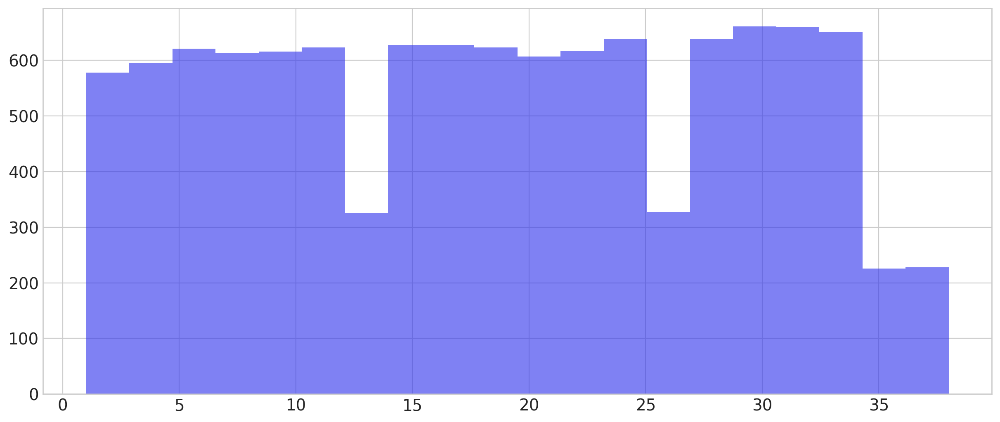

In [28]:
complete_data.gameday.hist(alpha=0.6, bins=20);

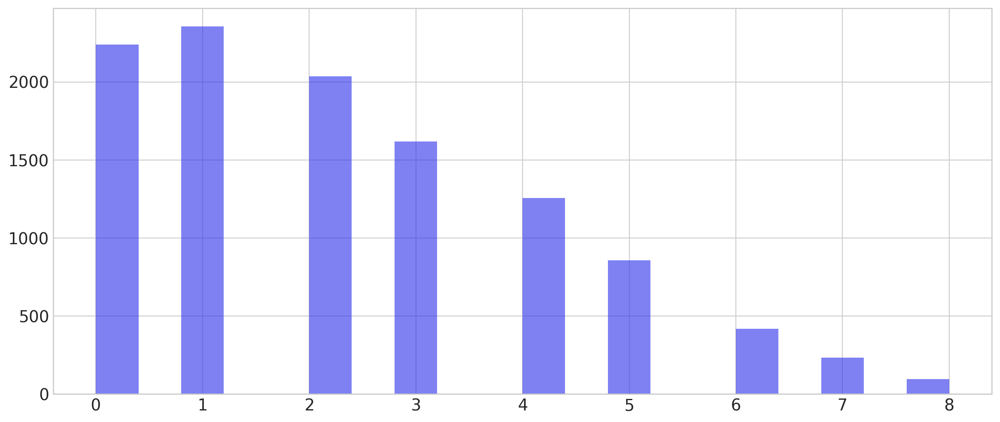

In [29]:
complete_data.season_nbr.hist(alpha=0.6, bins=20);

In [30]:
m_within, c_within = pm.gp.hsgp_approx.approx_hsgp_hyperparams(
    x_range=[0, complete_data.gameday.max()],
    lengthscale_range=[5, 25],
    cov_func="matern52",
)

print("Recommended smallest number of basis vectors (m):", m_within)
print("Recommended smallest scaling factor (c):", np.round(c_within, 1))

m_long, c_long = pm.gp.hsgp_approx.approx_hsgp_hyperparams(
    x_range=[0, complete_data.season_nbr.max()],
    lengthscale_range=[2, 6],
    cov_func="matern52",
)

print("Recommended smallest number of basis vectors (m):", m_long)
print("Recommended smallest scaling factor (c):", np.round(c_long, 1))

Recommended smallest number of basis vectors (m): 54
Recommended smallest scaling factor (c): 5.4
Recommended smallest number of basis vectors (m): 32
Recommended smallest scaling factor (c): 6.1


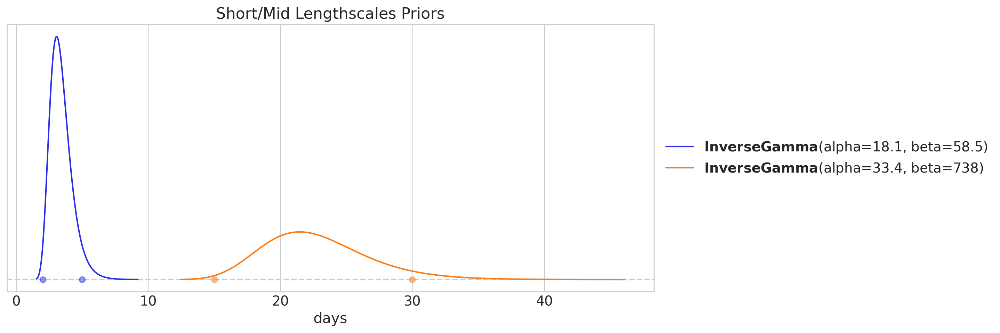

In [31]:
ls_short_dist, _ = pz.maxent(pz.InverseGamma(), 2, 5)
ls_medium_dist, ax = pz.maxent(pz.InverseGamma(), 15, 30)
ax.set(title="Short/Mid Lengthscales Priors", xlabel="days");

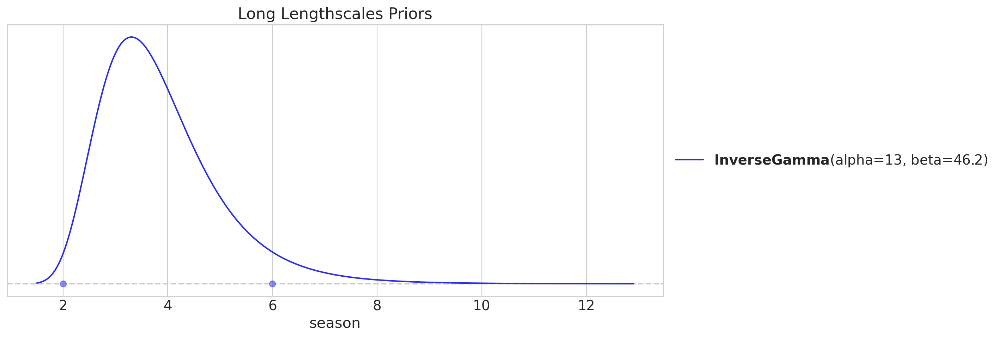

In [32]:
ls_long_dist, ax = pz.maxent(pz.InverseGamma(), 2, 6)
ax.set(title="Long Lengthscales Priors", xlabel="season");

We can now implement our PyMC model. It'll be a big one, but we'll take it step by step.

## PyMC Model

First, let's define some variables we'll use throughout our model building process:

In [33]:
# these don't change between train and test
unique_gamedays = complete_data["gameday"].sort_values().unique()
unique_seasons = complete_data["season_nbr"].sort_values().unique()

In [34]:
# these can change
player_idx = pd.Categorical(
    complete_data["name_player"], categories=players_ordered
).codes
gameday_idx = pd.Categorical(
    complete_data["gameday"],
    categories=unique_gamedays,
).codes

COORDS = {
    "event": complete_data["goals_cats"].factorize(sort=True)[1],
    "factor": factors,
    "gameday": unique_gamedays,
    "obs_id": complete_data.index,
    "player": players_ordered,
    "season": unique_seasons,
    "timescale": ["short", "medium", "long"],
}

Then, let's define the data containers for our model:

### Data containers

In [35]:
with pm.Model(coords=COORDS) as SFM_rlp:

    # Data containers
    factor_data = pm.Data(
        "factor_data", factors_sdz.to_numpy(), dims=("obs_id", "factor")
    )
    gameday_id = pm.Data("gameday_id", gameday_idx, dims="obs_id")
    player_id = pm.Data("player_id", player_idx, dims="obs_id")
    season_id = pm.Data(
        "season_id", complete_data["season_nbr"].to_numpy(), dims="obs_id"
    )
    goals_obs = pm.Data(
        "goals_obs", complete_data["goals_cats"].to_numpy(), dims="obs_id"
    )

### Players' skills

For the priors we use [those recommendations](https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations).

In [36]:
with SFM_rlp:
    intercept_sigma = 5
    sd = pm.Exponential("player_effect_diversity", 1)

    baseline_sigma = pt.sqrt(intercept_sigma**2 + sd**2 / len(COORDS["player"]))
    baseline = baseline_sigma * pm.Normal("baseline")

    player_effect = pm.Deterministic(
        "player_effect",
        baseline + pm.ZeroSumNormal("player_effect_raw", sigma=sd, dims="player"),
        dims="player",
    )

### HSGPs

#### Defining the HSGPs

In [37]:
with SFM_rlp:
    X_gamedays = pm.Data("X_gamedays", unique_gamedays, dims="gameday")[:, None]
    X_seasons = pm.Data("X_seasons", unique_seasons, dims="season")[:, None]

    ## 1% chance that amplitude > 2 goals
    alpha_scale, upper_scale = 0.01, 2.0
    amplitude = pm.Exponential(
        "amplitude", lam=-np.log(alpha_scale) / upper_scale, dims="timescale"
    )
    ls = pm.InverseGamma(
        "ls",
        alpha=np.array([ls_short_dist.alpha, ls_medium_dist.alpha, ls_long_dist.alpha]),
        beta=np.array([ls_short_dist.beta, ls_medium_dist.beta, ls_long_dist.beta]),
        dims="timescale",
    )

    # cov matrices
    cov_short = amplitude[0] ** 2 * pm.gp.cov.Matern52(input_dim=1, ls=ls[0])
    cov_medium = amplitude[1] ** 2 * pm.gp.cov.Matern52(input_dim=1, ls=ls[1])
    cov_within = cov_short + cov_medium
    cov_long = amplitude[2] ** 2 * pm.gp.cov.Matern52(input_dim=1, ls=ls[2])

    ## GPs
    gp_within = pm.gp.HSGP(m=[m_within], c=c_within, cov_func=cov_within)
    basis_vectors_within, sqrt_psd_within = gp_within.prior_linearized(X=X_gamedays)
    basis_coeffs_within = pm.Normal(
        "basis_coeffs_within", shape=gp_within.n_basis_vectors
    )
    f_within = pm.Deterministic(
        "f_within",
        basis_vectors_within @ (basis_coeffs_within * sqrt_psd_within),
        dims="gameday",
    )

    gp_long = pm.gp.HSGP(m=[m_long], c=c_long, cov_func=cov_long)
    basis_vectors_long, sqrt_psd_long = gp_long.prior_linearized(X=X_seasons)
    basis_coeffs_long = pm.Normal("basis_coeffs_long", shape=gp_long.n_basis_vectors)
    f_long = pm.Deterministic(
        "f_long",
        basis_vectors_long @ (basis_coeffs_long * sqrt_psd_long),
        dims="season",
    )

### Regression for player skills

In [38]:
with SFM_rlp:
    alpha = pm.Deterministic(
        "alpha",
        player_effect[player_id] + f_within[gameday_id] + f_long[season_id],
        dims="obs_id",
    )

### Adding team factors

> Partially pooled across teams

In [39]:
with SFM_rlp:
    slope = pm.Normal("slope", sigma=2.5, dims="factor")

### Likelihood

In [40]:
empirical_probs = complete_data["goals_cats"].value_counts(normalize=True).to_numpy()
cumulative_probs = empirical_probs.cumsum()[
    :-1
]  # get cumulative probabilities except the last one (which will be 1)

# inverse CDF of standard normal to convert to latent scale cutpoints
cutpoints_mu_standard = norm.ppf(cumulative_probs)

# Compute differences between cutpoints
delta_prior = np.diff(cutpoints_mu_standard)

In [41]:
with SFM_rlp:
    # regression
    eta = pm.Deterministic(
        "eta", alpha + pm.math.dot(factor_data, slope), dims="obs_id"
    )

    # Hyperpriors for the differences between cutpoints (delta)
    cutpoint_offset = 4
    delta_mean = pm.Normal(
        "delta_mean", mu=delta_prior * cutpoint_offset, sigma=1, shape=2
    )  # Mean of differences across all players
    delta_sigma = pm.Exponential(
        "delta_sigma", 1, shape=2
    )  # Variation of the differences

    # Player-specific differences (delta)
    delta_player = delta_mean + delta_sigma * pm.Normal(
        "delta_player", shape=(len(COORDS["player"]), 2)
    )

    # Cumulative sum to construct cutpoints
    # Ensure differences are positive using softplus
    # dims=("player", "cutpoint")
    cutpoints = pm.Deterministic(
        "cutpoints",
        pt.concatenate(
            [
                pt.full((player_effect.shape[0], 1), cutpoint_offset),
                pt.cumsum(pt.softplus(delta_player), axis=-1) + cutpoint_offset,
            ],
            axis=-1,
        ),  # Start at cutpoint_offset and sum differences
    )

    # likelihood
    pm.OrderedLogistic(
        "goals_scored",
        cutpoints=cutpoints[player_id],
        eta=eta,
        observed=goals_obs,
        dims="obs_id",
    )

## Model graph

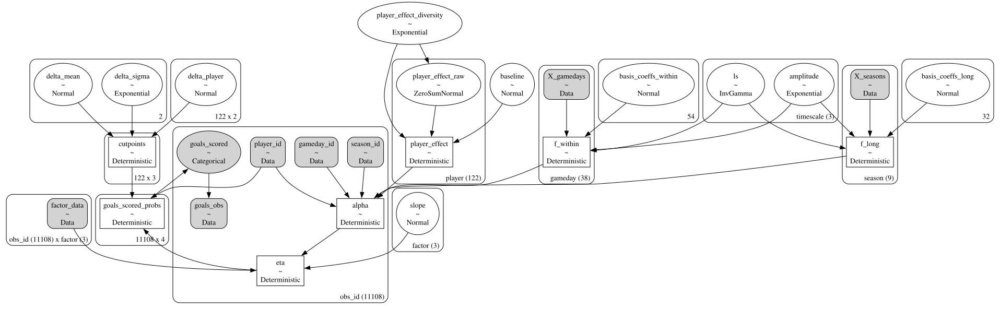

In [42]:
pm.model_to_graphviz(SFM_rlp)

## Prior Predictive Sampling

In [43]:
with SFM_rlp:
    idata = pm.sample_prior_predictive()

Sampling: [amplitude, baseline, basis_coeffs_long, basis_coeffs_within, delta_mean, delta_player, delta_sigma, goals_scored, ls, player_effect_diversity, player_effect_raw, slope]


In [44]:
idata.prior = idata.prior.rename({"goals_scored_probs_dim_1": "event"})

f_within_prior = idata.prior["f_within"]
f_long_prior = idata.prior["f_long"]

index = pd.MultiIndex.from_product(
    [unique_seasons, unique_gamedays],
    names=["season_nbr", "gameday"],
)
unique_combinations = pd.DataFrame(index=index).reset_index()

f_long_prior_aligned = f_long_prior.sel(
    season=unique_combinations["season_nbr"].to_numpy()
).rename({"season": "timestamp"})
f_long_prior_aligned["timestamp"] = unique_combinations.index

f_within_prior_aligned = f_within_prior.sel(
    gameday=unique_combinations["gameday"].to_numpy()
).rename({"gameday": "timestamp"})
f_within_prior_aligned["timestamp"] = unique_combinations.index

f_total_prior = f_long_prior_aligned + f_within_prior_aligned

some_draws = rng.choice(f_total_prior.draw, size=20, replace=True)

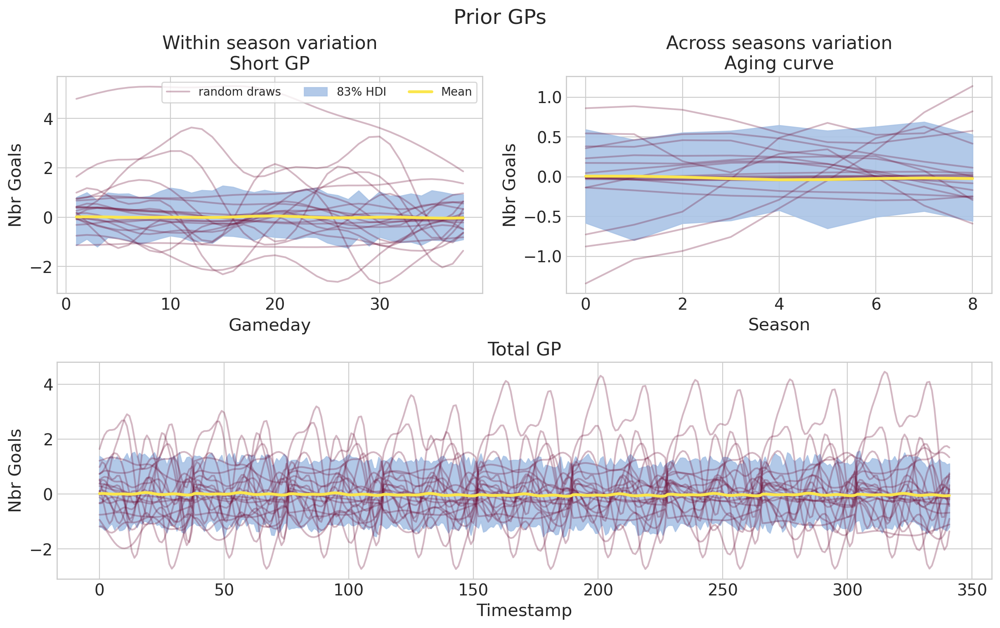

In [45]:
_, axes = plt.subplot_mosaic(
    """
    AB
    CC
    """,
    figsize=(12, 7.5),
    layout="constrained",
)

axes["A"].plot(
    f_within_prior.gameday,
    az.extract(f_within_prior)["f_within"].isel(sample=0),
    color="#70133A",
    alpha=0.3,
    lw=1.5,
    label="random draws",
)
axes["A"].plot(
    f_within_prior.gameday,
    az.extract(f_within_prior)["f_within"].isel(sample=some_draws),
    color="#70133A",
    alpha=0.3,
    lw=1.5,
)
az.plot_hdi(
    x=f_within_prior.gameday,
    y=f_within_prior,
    hdi_prob=0.83,
    color="#AAC4E6",
    fill_kwargs={"alpha": 0.9, "label": r"$83\%$ HDI"},
    ax=axes["A"],
    smooth=False,
)
axes["A"].plot(
    f_within_prior.gameday,
    f_within_prior.mean(("chain", "draw")),
    color="#FBE64D",
    lw=2.5,
    label="Mean",
)
axes["A"].set(
    xlabel="Gameday", ylabel="Nbr Goals", title="Within season variation\nShort GP"
)
axes["A"].legend(fontsize=10, frameon=True, ncols=3)

axes["B"].plot(
    f_long_prior.season,
    az.extract(f_long_prior)["f_long"].isel(sample=some_draws),
    color="#70133A",
    alpha=0.3,
    lw=1.5,
)
az.plot_hdi(
    x=f_long_prior.season,
    y=f_long_prior,
    hdi_prob=0.83,
    color="#AAC4E6",
    fill_kwargs={"alpha": 0.9},
    ax=axes["B"],
    smooth=False,
)
axes["B"].plot(
    f_long_prior.season,
    f_long_prior.mean(("chain", "draw")),
    color="#FBE64D",
    lw=2.5,
)
axes["B"].set(
    xlabel="Season", ylabel="Nbr Goals", title="Across seasons variation\nAging curve"
)

axes["C"].plot(
    f_total_prior.timestamp,
    az.extract(f_total_prior)["x"].isel(sample=some_draws),
    color="#70133A",
    alpha=0.3,
    lw=1.5,
)
az.plot_hdi(
    x=f_total_prior.timestamp,
    y=f_total_prior,
    hdi_prob=0.83,
    color="#AAC4E6",
    fill_kwargs={"alpha": 0.9},
    ax=axes["C"],
    smooth=False,
)
axes["C"].plot(
    f_total_prior.timestamp,
    f_total_prior.mean(("chain", "draw")),
    color="#FBE64D",
    lw=2.5,
)
axes["C"].set(xlabel="Timestamp", ylabel="Nbr Goals", title="Total GP")
plt.suptitle("Prior GPs", fontsize=18);

## Prior checks

### Prior cutpoints

In [46]:
mindex_coords_original = xr.Coordinates.from_pandas_multiindex(
    complete_data.set_index(["name_player", "season", "gameday"]).index,
    "obs_id",
)

idata.prior = idata.prior.assign_coords(mindex_coords_original)
idata.prior_predictive = idata.prior_predictive.assign_coords(mindex_coords_original)
idata.observed_data = idata.observed_data.assign_coords(mindex_coords_original)

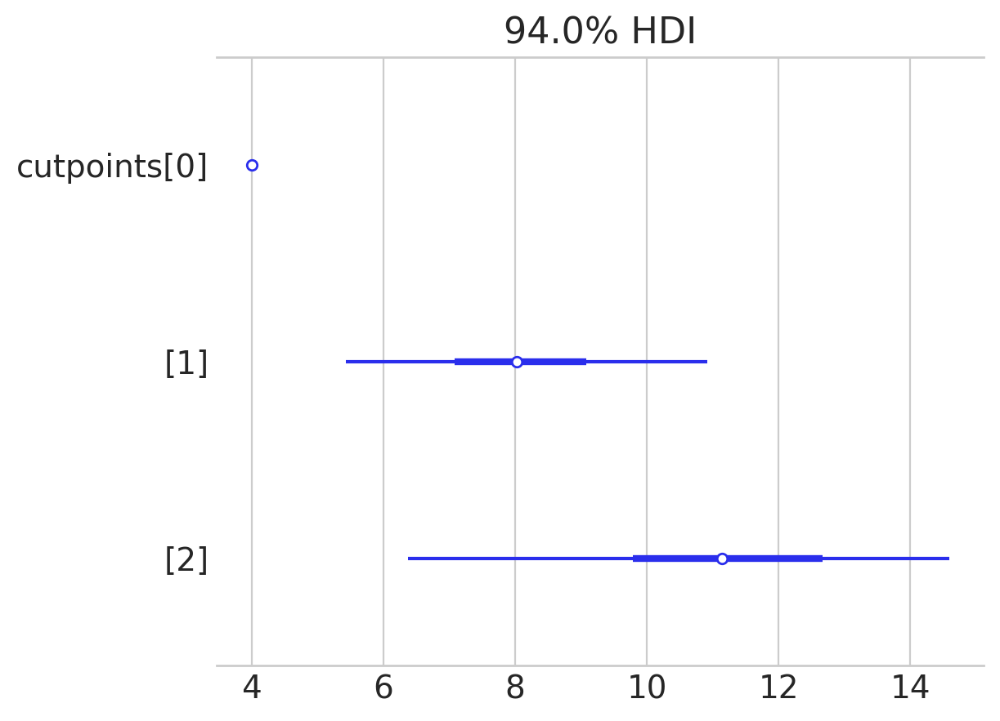

In [47]:
az.plot_forest(idata.prior["cutpoints"].sel(cutpoints_dim_0=0));

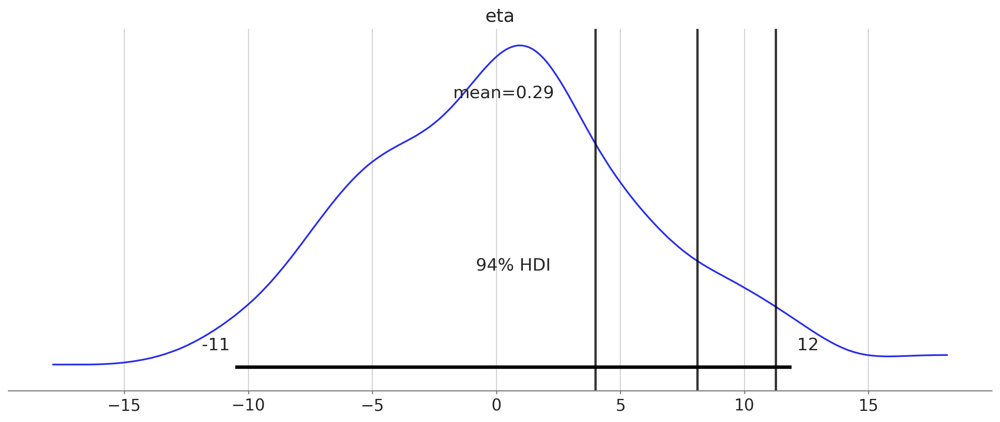

In [48]:
K = len(idata.prior["cutpoints"].cutpoints_dim_1)

ax = az.plot_posterior(idata.prior["eta"].isel(obs_id=0))
for i in range(K):
    ax.axvline(
        idata.prior["cutpoints"].isel(cutpoints_dim_0=0, cutpoints_dim_1=i).mean().data,
        color="k",
        lw=2,
        alpha=0.8,
    )

In [49]:
implied_probs_prior = (
    az.extract(idata.prior, var_names="goals_scored_probs")
    .rename({"goals_scored_probs_dim_0": "obs_id"})
    .assign_coords(mindex_coords_original)
)

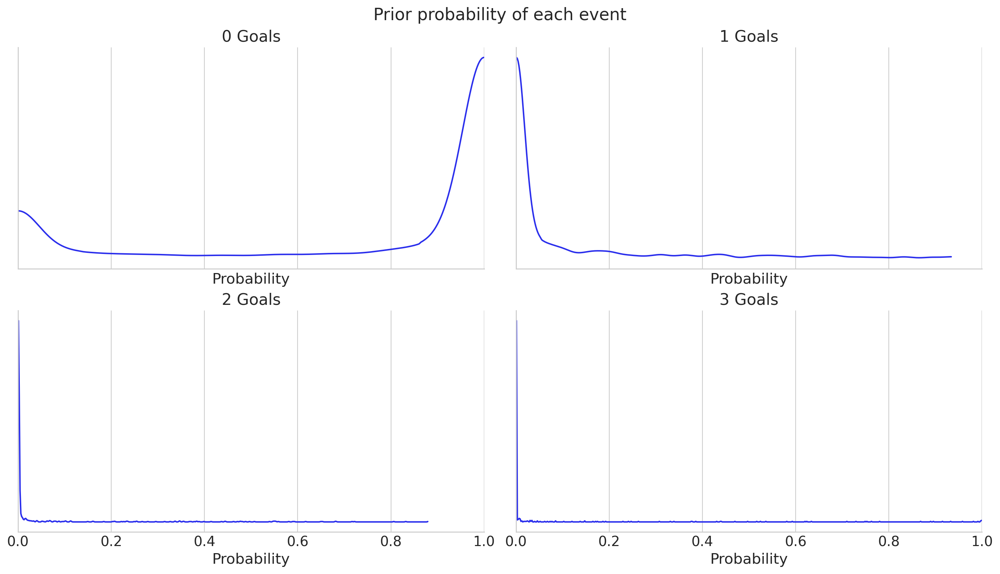

In [50]:
_, axes = plt.subplots(2, 2, figsize=(14, 8), sharex=True, layout="constrained")
axes = axes.flatten()

for i, ax in enumerate(axes):
    az.plot_dist(implied_probs_prior.isel(obs_id=0, event=i), ax=ax)
    ax.set(xlabel="Probability", yticklabels="", title=f"{i} Goals", xlim=[0, 1])
    ax.set_yticks([])
    sns.despine()
plt.suptitle("Prior probability of each event", fontsize=17);

In [51]:
implied_class = az.extract(idata.prior_predictive, var_names="goals_scored")

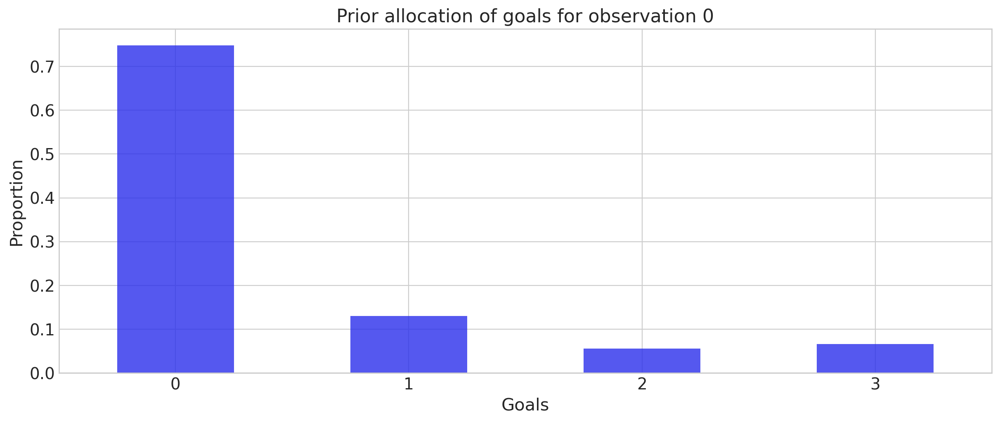

In [52]:
ax = (
    implied_class.isel(obs_id=0)
    .to_pandas()
    .reset_index(drop=True)
    .value_counts(normalize=True)
    .sort_index()
    .plot(kind="bar", rot=0, alpha=0.8)
)
ax.set(
    xlabel="Goals",
    ylabel="Proportion",
    title="Prior allocation of goals for observation 0",
);

### Prior predictive checks

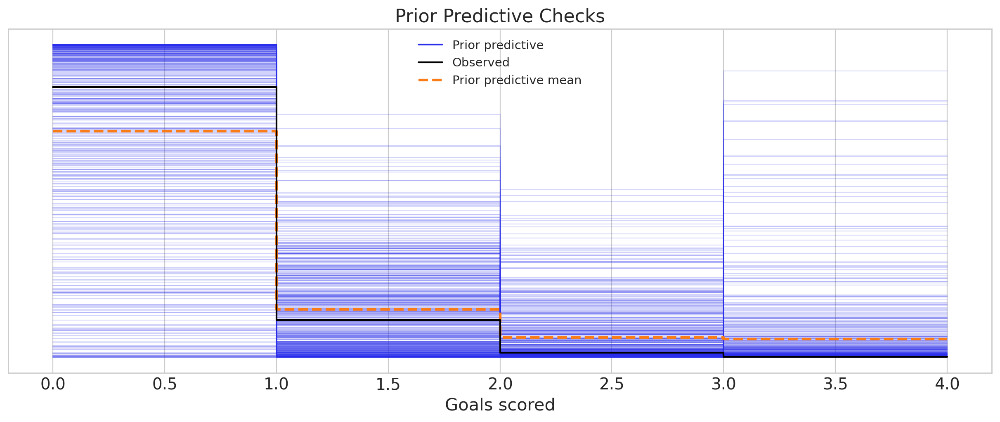

In [53]:
ax = az.plot_ppc(idata, group="prior", observed=True)
ax.set(xlabel="Goals scored", title="Prior Predictive Checks");

## Sampling and convergence checks

In [54]:
with SFM_rlp:
    #idata.extend(pm.sample(nuts_sampler="numpyro", target_accept=0.99))
    idata.extend(pm.sample(target_accept=0.99))

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [player_effect_diversity, baseline, player_effect_raw, amplitude, ls, basis_coeffs_within, basis_coeffs_long, slope, delta_mean, delta_sigma, delta_player]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 530 seconds.
There were 12 divergences after tuning. Increase `target_accept` or reparameterize.


In [55]:
idata.prior = idata.prior.reset_index("obs_id")
idata.prior_predictive = idata.prior_predictive.reset_index("obs_id")
idata.observed_data = idata.observed_data.reset_index("obs_id")

In [56]:
az.to_netcdf(idata, "idata_complete.nc")

'idata_complete.nc'

In [57]:
idata.sample_stats.acceptance_rate.mean().data.round(2)

0.98

In [58]:
idata.sample_stats.diverging.sum().data

array(12)

In [59]:
az.ess(idata).min().to_pandas().sort_values().round()

slope                       693.0
player_effect_diversity     814.0
alpha                       960.0
delta_sigma                1083.0
player_effect              1207.0
goals_scored_probs         1278.0
eta                        1278.0
amplitude                  1460.0
player_effect_raw          1463.0
baseline                   1572.0
f_long                     1910.0
f_within                   2300.0
delta_mean                 2476.0
cutpoints                  2701.0
delta_player               3254.0
basis_coeffs_within        3543.0
basis_coeffs_long          4070.0
ls                         4252.0
dtype: float64

In [60]:
az.summary(
    idata,
    var_names=[
        "amplitude",
        "baseline",
        "player_effect_diversity",
        "ls",
        "slope",
        "delta_sigma",
        "delta_mean",
    ],
    round_to=2,
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
amplitude[short],0.06,0.05,0.00,0.14,0.00,0.00,2198.90,2327.87,1.00
amplitude[medium],0.17,0.17,0.00,0.47,0.00,0.00,1696.95,1796.87,1.00
amplitude[long],0.16,0.16,0.00,0.45,0.00,0.01,1460.43,2050.65,1.00
baseline,0.31,0.06,0.20,0.43,0.00,0.00,1571.77,1190.43,1.00
player_effect_diversity,0.76,0.09,0.59,0.93,0.00,0.00,813.87,1433.22,1.01
ls[short],3.48,0.91,1.97,5.12,0.01,0.02,5424.04,2545.66,1.00
ls[medium],23.01,4.02,15.90,30.50,0.06,0.07,4713.21,2880.12,1.00
ls[long],3.98,1.24,1.96,6.13,0.02,0.03,4251.69,2316.49,1.00
slope[center],0.95,0.18,0.61,1.29,0.01,0.00,692.89,1350.48,1.01
slope[home_pitch],0.14,0.06,0.03,0.25,0.00,0.00,4656.24,2943.01,1.00


In [61]:
az.ess(
    idata,
    var_names=["basis_coeffs_long", "basis_coeffs_within"],
).min().to_pandas().round(2)

basis_coeffs_long      4070.13
basis_coeffs_within    3543.40
dtype: float64

In [62]:
az.rhat(
    idata,
    var_names=["basis_coeffs_long", "basis_coeffs_within"],
).max().to_pandas().round(2)

basis_coeffs_long      1.01
basis_coeffs_within    1.01
dtype: float64

/Users/rebane/miniconda3/envs/football-models/lib/python3.12/site-packages/arviz/utils.py:146: UserWarning: Items starting with ~: ['hsgp_coeffs'] have not been found and will be ignored
  warnings.warn(
/Users/rebane/miniconda3/envs/football-models/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


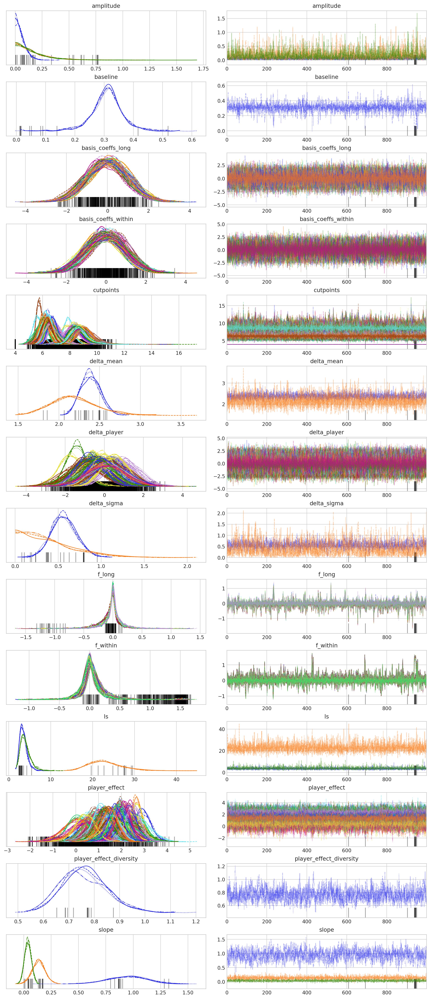

In [63]:
az.plot_trace(
    idata,
    var_names=["~alpha", "~goals_scored_probs", "~eta", "~_raw", "~hsgp_coeffs"],
    filter_vars="regex",
);

## Posterior parameters

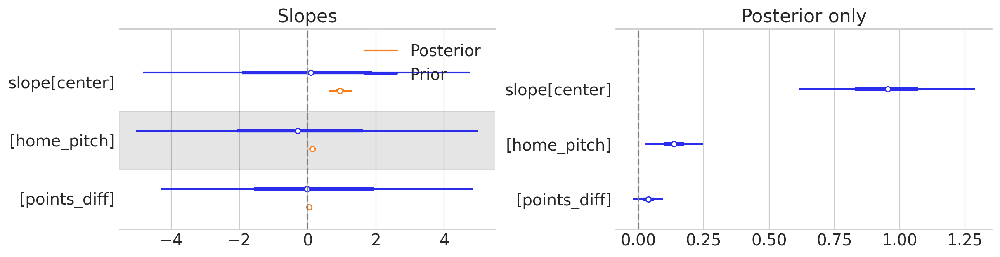

In [64]:
_, axes = plt.subplot_mosaic(
    """
    AB
    """,
    figsize=(12, 3),
    layout="constrained",
)

az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names=["slope"],
    combined=True,
    ax=axes["A"],
)
axes["A"].axvline(c="grey", ls="--")
axes["A"].set(title="Slopes")

az.plot_forest(
    idata,
    var_names=["slope"],
    combined=True,
    ax=axes["B"],
)
axes["B"].axvline(c="grey", ls="--")
axes["B"].set(title="Posterior only");

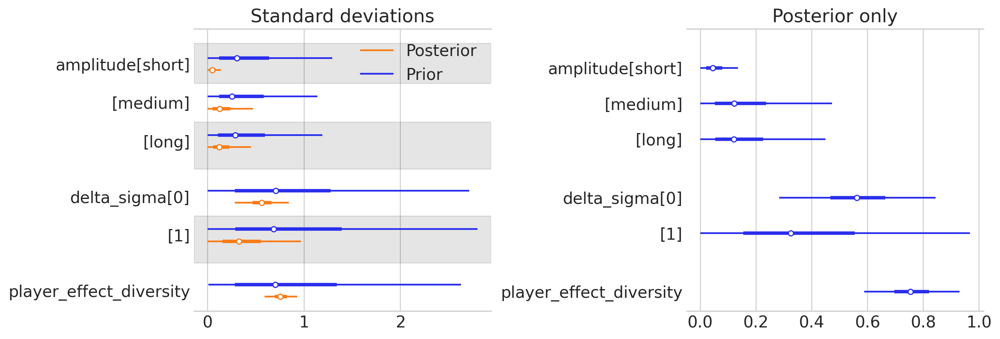

In [65]:
_, axes = plt.subplot_mosaic(
    """
    AB
    """,
    figsize=(12, 4),
    layout="constrained",
)

az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names=["diversity", "amplitude", "sd_", "_sigma"],
    combined=True,
    filter_vars="regex",
    ax=axes["A"],
)
axes["A"].set(title="Standard deviations")

az.plot_forest(
    idata,
    var_names=["diversity", "amplitude", "sd_", "_sigma"],
    combined=True,
    filter_vars="regex",
    ax=axes["B"],
)
axes["B"].set(title="Posterior only");

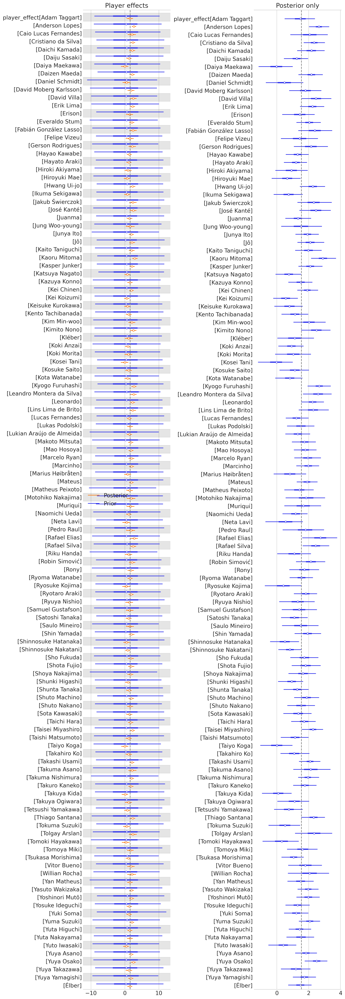

In [66]:
_, axes = plt.subplot_mosaic(
    """
    AB
    """,
    figsize=(12, 35),
    layout="constrained",
)

az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="player_effect",
    combined=True,
    ax=axes["A"],
)
axes["A"].axvline(x=idata.posterior.player_effect.mean(), c="grey", ls="--")
axes["A"].set(title="Player effects")

az.plot_forest(
    idata,
    var_names="player_effect",
    combined=True,
    ax=axes["B"],
)
axes["B"].axvline(x=idata.posterior.player_effect.mean(), c="grey", ls="--")
axes["B"].set(title="Posterior only");

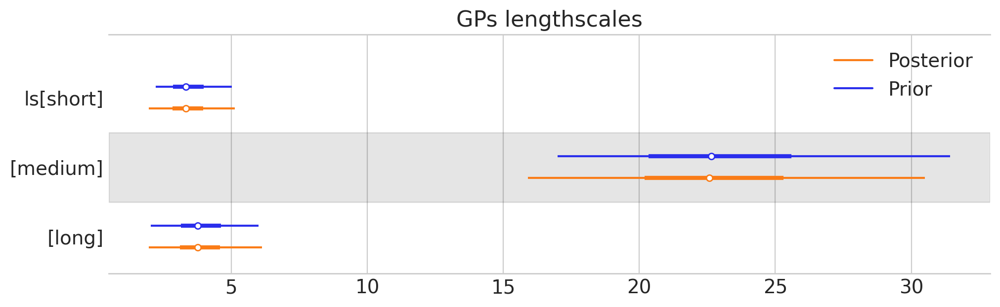

In [67]:
ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="ls",
    combined=True,
    figsize=(10, 3),
)
ax[0].set(title="GPs lengthscales");

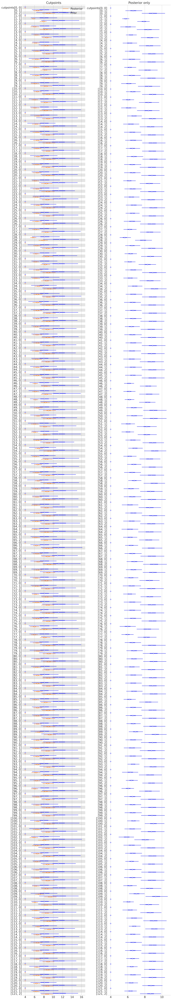

In [68]:
_, axes = plt.subplot_mosaic(
    """
    AB
    """,
    figsize=(12, 70),
    layout="constrained",
)
az.plot_forest(
    [idata.prior["cutpoints"], idata.posterior["cutpoints"]],
    combined=True,
    model_names=["Prior", "Posterior"],
    ax=axes["A"],
)
axes["A"].set(title="Cutpoints")
az.plot_forest(
    idata,
    var_names=["cutpoints"],
    combined=True,
    ax=axes["B"],
)
axes["B"].set(title="Posterior only");

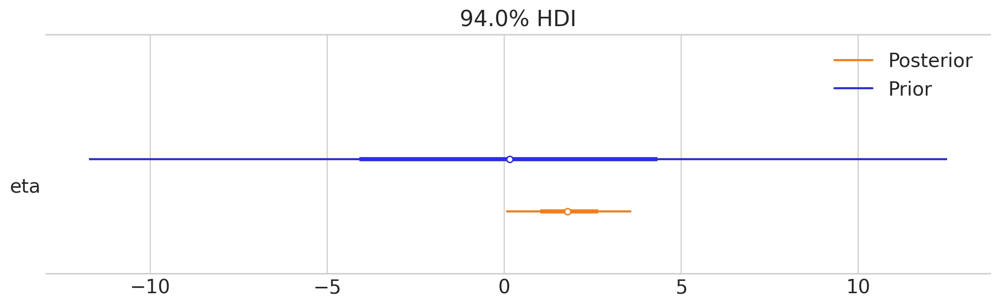

In [69]:
az.plot_forest(
    [idata.prior["eta"], idata.posterior["eta"]],
    combine_dims={"chain", "draw", "obs_id"},
    combined=True,
    model_names=["Prior", "Posterior"],
    figsize=(10, 3),
);

## Performance evolution through time

In [70]:
f_long_post = idata.posterior["f_long"]
f_within_post = idata.posterior["f_within"]

f_long_post_aligned = f_long_post.sel(
    season=unique_combinations["season_nbr"].to_numpy()
).rename({"season": "timestamp"})
f_long_post_aligned["timestamp"] = unique_combinations.index

f_within_post_aligned = f_within_post.sel(
    gameday=unique_combinations["gameday"].to_numpy()
).rename({"gameday": "timestamp"})
f_within_post_aligned["timestamp"] = unique_combinations.index

f_total_post = f_long_post_aligned + f_within_post_aligned

some_draws = rng.choice(4000, size=20, replace=True)

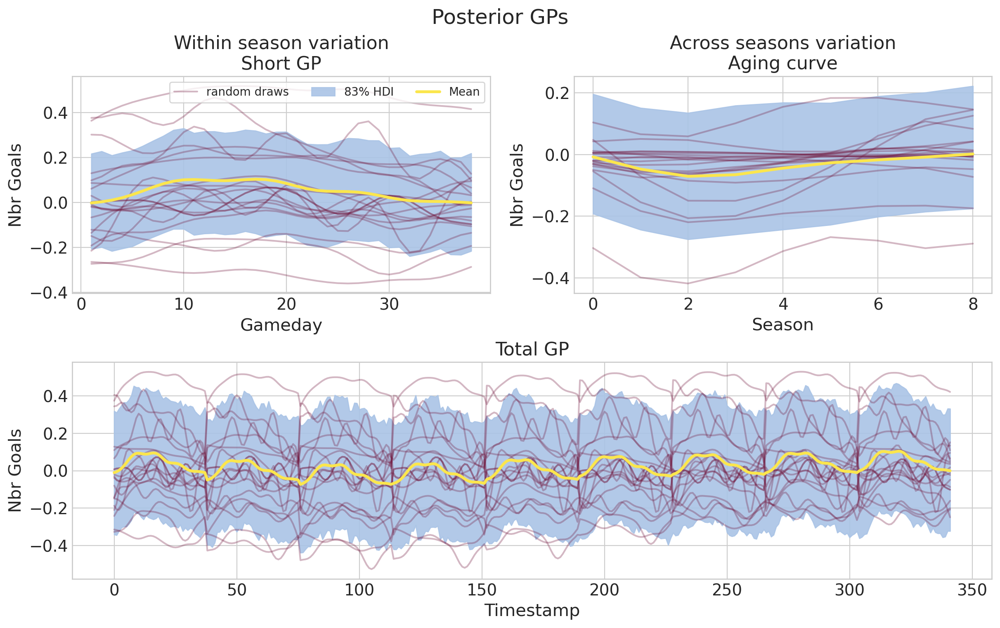

In [71]:
_, axes = plt.subplot_mosaic(
    """
    AB
    CC
    """,
    figsize=(12, 7.5),
    layout="constrained",
)

axes["A"].plot(
    f_within_post.gameday,
    az.extract(f_within_post)["f_within"].isel(sample=0),
    color="#70133A",
    alpha=0.3,
    lw=1.5,
    label="random draws",
)
axes["A"].plot(
    f_within_post.gameday,
    az.extract(f_within_post)["f_within"].isel(sample=some_draws),
    color="#70133A",
    alpha=0.3,
    lw=1.5,
)
az.plot_hdi(
    x=f_within_post.gameday,
    y=f_within_post,
    hdi_prob=0.83,
    color="#AAC4E6",
    fill_kwargs={"alpha": 0.9, "label": r"$83\%$ HDI"},
    ax=axes["A"],
    smooth=False,
)
axes["A"].plot(
    f_within_post.gameday,
    f_within_post.mean(("chain", "draw")),
    color="#FBE64D",
    lw=2.5,
    label="Mean",
)
axes["A"].set(
    xlabel="Gameday", ylabel="Nbr Goals", title="Within season variation\nShort GP"
)
axes["A"].legend(fontsize=10, frameon=True, ncols=3)

axes["B"].plot(
    f_long_post.season,
    az.extract(f_long_post)["f_long"].isel(sample=some_draws),
    color="#70133A",
    alpha=0.3,
    lw=1.5,
)
az.plot_hdi(
    x=f_long_post.season,
    y=f_long_post,
    hdi_prob=0.83,
    color="#AAC4E6",
    fill_kwargs={"alpha": 0.9},
    ax=axes["B"],
    smooth=False,
)
axes["B"].plot(
    f_long_post.season,
    f_long_post.mean(("chain", "draw")),
    color="#FBE64D",
    lw=2.5,
)
axes["B"].set(
    xlabel="Season", ylabel="Nbr Goals", title="Across seasons variation\nAging curve"
)

axes["C"].plot(
    f_total_post.timestamp,
    az.extract(f_total_post)["x"].isel(sample=some_draws),
    color="#70133A",
    alpha=0.3,
    lw=1.5,
)
az.plot_hdi(
    x=f_total_post.timestamp,
    y=f_total_post,
    hdi_prob=0.83,
    color="#AAC4E6",
    fill_kwargs={"alpha": 0.9},
    ax=axes["C"],
    smooth=False,
)
axes["C"].plot(
    f_total_post.timestamp,
    f_total_post.mean(("chain", "draw")),
    color="#FBE64D",
    lw=2.5,
)
axes["C"].set(xlabel="Timestamp", ylabel="Nbr Goals", title="Total GP")
plt.suptitle("Posterior GPs", fontsize=18);

## PAR Analysis

### From posterior samples

In [72]:
with SFM_rlp:
    idata.extend(
        pm.sample_posterior_predictive(idata, compile_kwargs={"mode": "NUMBA"})
    )

Sampling: [goals_scored]


Output()

In [73]:
idata.posterior = idata.posterior.assign_coords(mindex_coords_original)
idata.posterior_predictive = idata.posterior_predictive.assign_coords(
    mindex_coords_original
)
idata.observed_data = idata.observed_data.assign_coords(mindex_coords_original)

idata.posterior = idata.posterior.rename({"goals_scored_probs_dim_1": "event"})

In [78]:
ELITE_LEVEL = pd.read_csv("../data-download/data/j1l_elite_players.csv").players.values
ELITE_LEVEL

array(['Anderson Lopes', 'Erison', 'Hayao Kawabe', 'Hayato Araki',
       'Ikuma Sekigawa', 'Kasper Junker', 'Lucas Fernandes',
       'Makoto Mitsuta', 'Mao Hosoya', 'Marius Høibråten', 'Mateus',
       'Naomichi Ueda', 'Rafael Elias', 'Samuel Gustafson',
       'Shinnosuke Nakatani', 'Shunki Higashi', 'Shunta Tanaka',
       'Taisei Miyashiro', 'Takuro Kaneko', 'Tsukasa Morishima',
       'Vitor Bueno', 'Yan Matheus', 'Yasuto Wakizaka', 'Yuki Soma',
       'Yuma Suzuki'], dtype=object)

In [79]:
REPLACEMENT_LEVEL = pd.read_csv("../data-download/data/j1l_replacement_players.csv").players.values
REPLACEMENT_LEVEL

array(['Adam Taggart', 'Caio Lucas Fernandes', 'Cristiano da Silva',
       'Daichi Kamada', 'Daiju Sasaki', 'Daiya Maekawa', 'Daizen Maeda',
       'Daniel Schmidt', 'David Moberg Karlsson', 'David Villa',
       'Erik Lima', 'Everaldo Stum', 'Fabián González Lasso',
       'Felipe Vizeu', 'Gerson Rodrigues', 'Hiroki Akiyama',
       'Hiroyuki Mae', 'Hwang Ui-jo', 'Jakub Świerczok', 'José Kanté',
       'Juanma', 'Jung Woo-young', 'Junya Ito', 'Jô', 'Kaito Taniguchi',
       'Kaoru Mitoma', 'Katsuya Nagato', 'Kazuya Konno', 'Kei Chinen',
       'Kei Koizumi', 'Keisuke Kurokawa', 'Kento Tachibanada',
       'Kim Min-woo', 'Kimito Nono', 'Kléber', 'Koki Anzai',
       'Koki Morita', 'Kosei Tani', 'Kosuke Saito', 'Kota Watanabe',
       'Kyogo Furuhashi', 'Leandro Montera da Silva', 'Leonardo',
       'Lins Lima de Brito', 'Lukas Podolski', 'Lukian Araújo de Almeida',
       'Marcelo Ryan', 'Marcinho', 'Matheus Peixoto', 'Motohiko Nakajima',
       'Muriqui', 'Neta Lavi', 'Pedro Raul', '

In [80]:
post_preds = idata.posterior_predictive.reset_index("obs_id")
rlp_perf = post_preds["goals_scored"].where(
    post_preds["name_player"].isin(REPLACEMENT_LEVEL), drop=True
)
elite_perf = post_preds["goals_scored"].where(
    post_preds["name_player"].isin(ELITE_LEVEL), drop=True
)
PAR = (
    elite_perf.groupby("name_player").mean("obs_id") - rlp_perf.mean("obs_id")
).rename("PAR")

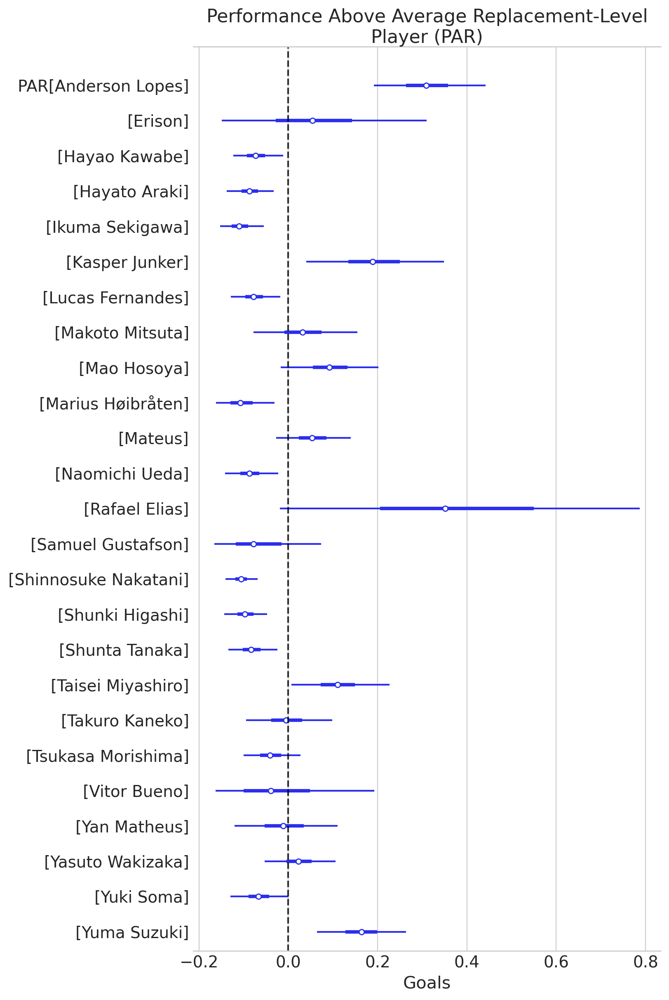

In [81]:
ax = az.plot_forest(PAR, combined=True, figsize=(8, 12))
ax[0].axvline(c="k", ls="--", alpha=0.8)
ax[0].set(
    title="Performance Above Average Replacement-Level Player (PAR)", xlabel="Goals"
);

### From equal teams

In [82]:
with SFM_rlp:
    # all teams are equal
    pm.set_data({"factor_data": np.zeros_like(factors_sdz)})

    counterfact_preds = pm.sample_posterior_predictive(
        idata,
        var_names=["goals_scored"],
        predictions=True,
        compile_kwargs={"mode": "NUMBA"},
    )

Sampling: [goals_scored]


Output()

In [83]:
counterfact_preds.predictions = counterfact_preds.predictions.assign_coords(
    mindex_coords_original
)

preds = counterfact_preds.predictions["goals_scored"].reset_index("obs_id")
rlp_perf = preds.where(preds["name_player"].isin(REPLACEMENT_LEVEL), drop=True)
elite_perf = preds.where(preds["name_player"].isin(ELITE_LEVEL), drop=True)

SAR = (
    elite_perf.groupby("name_player").mean("obs_id") - rlp_perf.mean("obs_id")
).rename("SAR")
diff = SAR - PAR

In [84]:
PLAYER_SUBSET = [
    "Anderson Lopes", "Erison", "Hayao Kawabe", "Hayato Araki"
]
SAR_plot = SAR.where(SAR["name_player"].isin(PLAYER_SUBSET), drop=True).rename("")
diff_plot = diff.where(diff["name_player"].isin(PLAYER_SUBSET), drop=True).rename("")

SAR_mean = SAR_plot.mean(("chain", "draw"))

# sort indices based on means in descending order
sorted_indices = np.argsort(-SAR_mean.to_numpy())

# reorder based on sorted indices
sorted_SAR_plot = SAR_plot.isel(name_player=sorted_indices)
sorted_SAR_plot["name_player"] = sorted_SAR_plot.name_player.str.replace(
    "-", " "
).str.title()
sorted_diff_plot = diff_plot.isel(name_player=sorted_indices)
sorted_diff_plot["name_player"] = sorted_diff_plot.name_player.str.replace(
    "-", " "
).str.title()

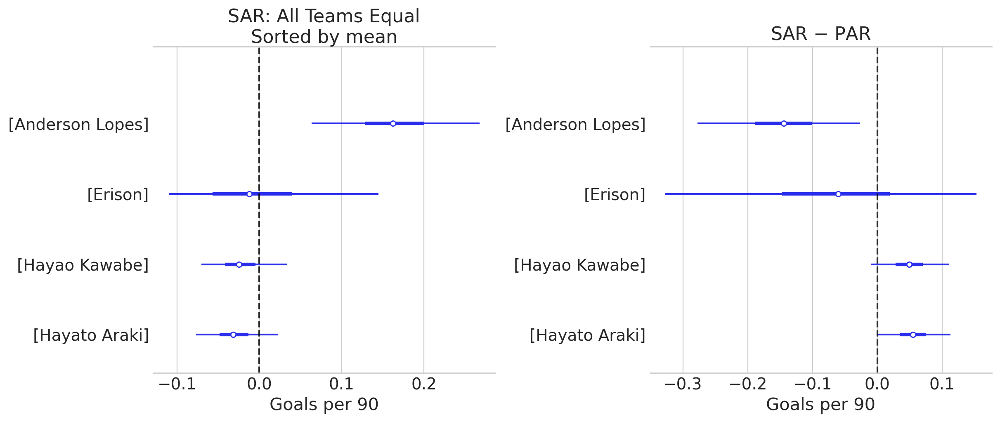

In [85]:
_, (left, right) = plt.subplots(1, 2)

az.plot_forest(sorted_SAR_plot, combined=True, ax=left)
az.plot_forest(sorted_diff_plot, combined=True, ax=right)

left.axvline(c="k", ls="--", alpha=0.8)
left.set(title="SAR: All Teams Equal\nSorted by mean", xlabel="Goals per 90")
right.axvline(c="k", ls="--", alpha=0.8)
right.set(title="SAR $-$ PAR", xlabel="Goals per 90");

## Versioning

In [86]:
%load_ext watermark
%watermark -n -u -v -iv -w

Last updated: Sat May 24 2025

Python implementation: CPython
Python version       : 3.12.10
IPython version      : 9.2.0

arviz     : 0.21.0
pandas    : 2.2.3
numpy     : 1.26.4
pytensor  : 2.30.3
xarray    : 2025.4.0
seaborn   : 0.13.2
preliz    : 0.17.0
sklearn   : 1.6.1
pymc      : 5.22.0
matplotlib: 3.10.3

Watermark: 2.5.0



## TODO: Plots to update if selected

### Posterior predictive checks

In [48]:
idata.posterior = idata.posterior.rename({"goals_scored_probs_dim_1": "event"})
idata.posterior = idata.posterior.assign_coords(mindex_coords_original)
idata.posterior_predictive = idata.posterior_predictive.assign_coords(
    mindex_coords_original
)

In [51]:
ax = az.plot_ppc(idata)
ax.set(xlabel="Goals scored", title="Posterior Predictive Checks");

TypeError: `data` argument must have the group "posterior_predictive" for ppcplot

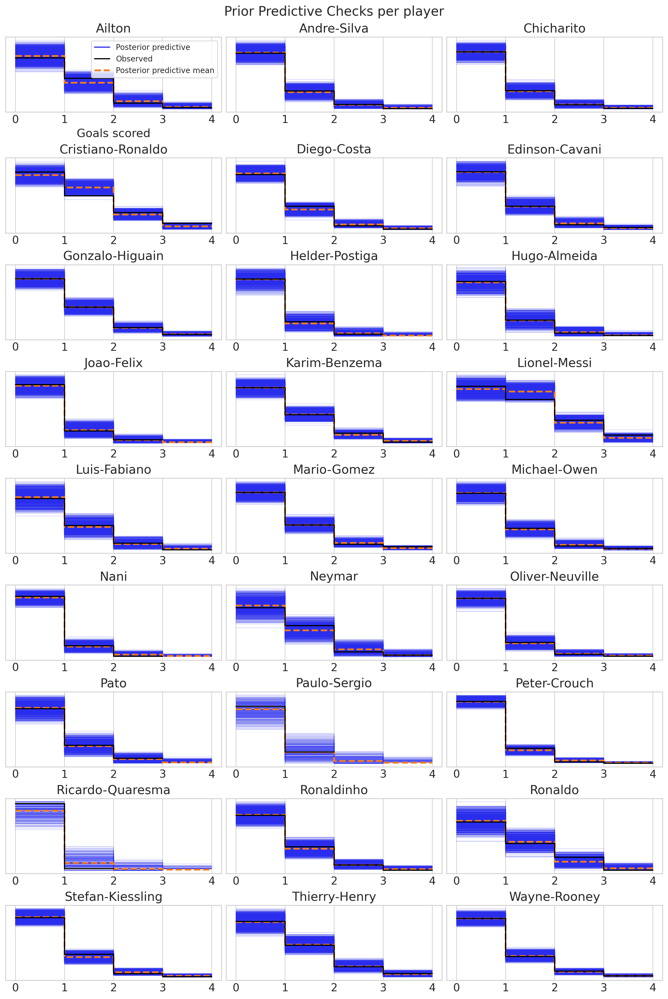

In [50]:
_, axes = plt.subplots(9, 3, figsize=(12, 18))
axes = axes.flatten()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    idata_plot = idata.copy()
    idata_plot.observed_data = idata.observed_data.sel(name_player=player)
    idata_plot.posterior_predictive = idata.posterior_predictive.sel(name_player=player)

    az.plot_ppc(idata_plot, ax=ax)
    ax.set(xlabel="Goals scored", yticklabels=[], title=player.title())
    if i > 0:
        ax.get_legend().remove()
        ax.set(xlabel="")
    else:
        ax.legend(fontsize=10, frameon=True)

plt.suptitle("Prior Predictive Checks per player", fontsize=17);

### Categorical probabilities

In [51]:
implied_probs_post = (
    idata.posterior["goals_scored_probs"]
    .rename({"goals_scored_probs_dim_0": "obs_id"})
    .assign_coords(mindex_coords_original)
)

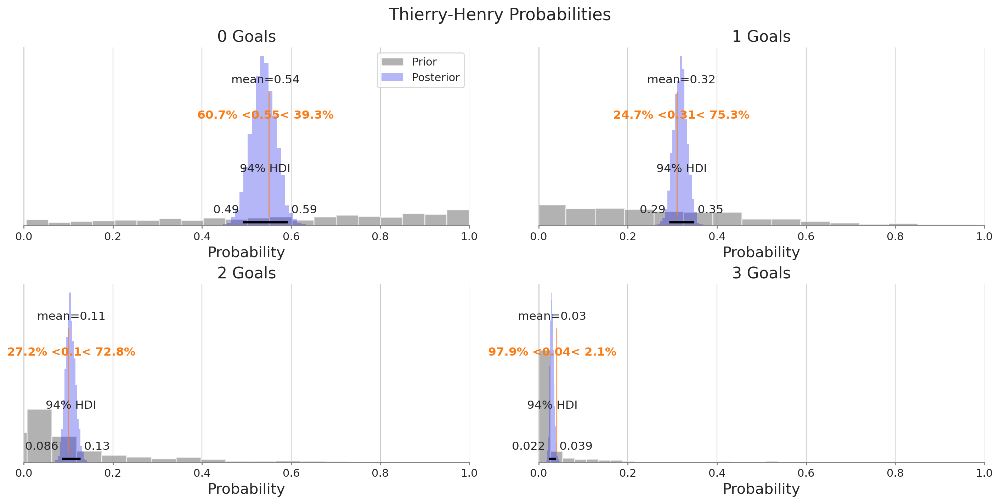

In [52]:
PLAYER = "thierry-henry"
player_probs_prior = implied_probs_prior.sel(name_player=PLAYER)
player_probs_post = implied_probs_post.sel(name_player=PLAYER)
empirics = (
    idata.observed_data.sel(name_player=PLAYER)["goals_scored"]
    .to_pandas()
    .value_counts(normalize=True)
)

_, axes = plt.subplots(2, 2, figsize=(14, 7), layout="constrained")
axes = axes.flatten()

for i, ax in enumerate(axes):
    ax.hist(
        player_probs_prior.sel(event=i).mean("obs_id"),
        color="grey",
        ec="white",
        bins=20,
        alpha=0.6,
        label="Prior",
    )
    az.plot_posterior(
        player_probs_post.sel(event=i).mean("obs_id"),
        label="Posterior",
        ax=ax,
        ref_val=empirics[i].round(2),
        textsize=11,
        kind="hist",
        bins=20,
    )
    ax.set(xlabel="Probability", yticklabels="", title=f"{i} Goals", xlim=[0, 1])
    ax.set_yticks([])
    sns.despine()
    if i == 0:
        ax.legend(fontsize=11, frameon=True)
plt.suptitle(f"{PLAYER.title()} Probabilities", fontsize=17);

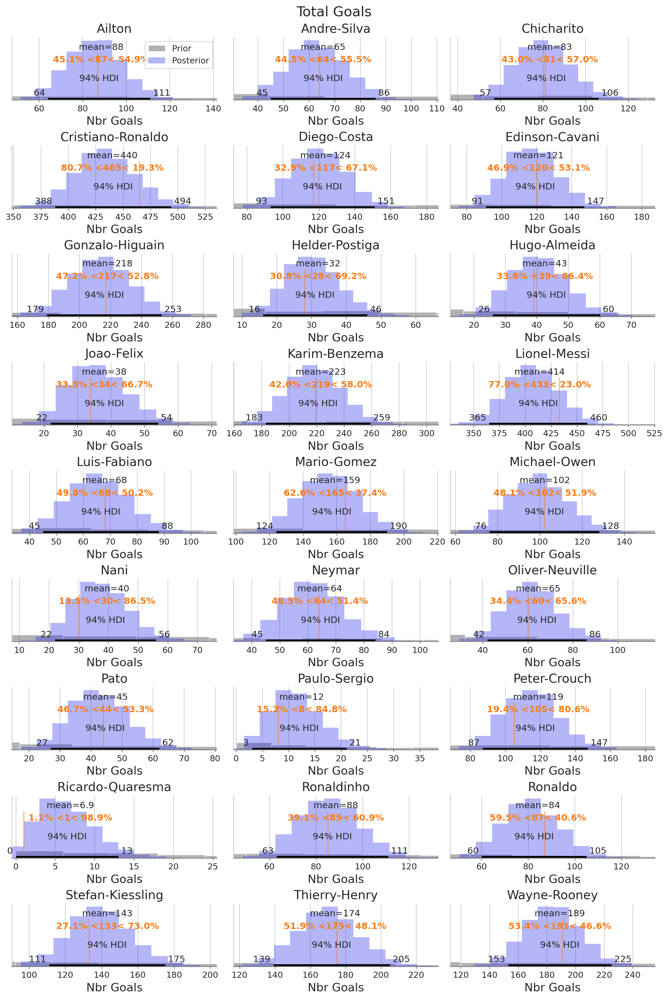

In [53]:
_, axes = plt.subplots(9, 3, figsize=(12, 18), layout="constrained")
axes = axes.flatten()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    goals_prior = (
        az.extract(idata.prior_predictive, var_names="goals_scored")
        .sel(name_player=player)
        .sum("obs_id")
    )
    goals_post = (
        idata.posterior_predictive["goals_scored"].sel(name_player=player).sum("obs_id")
    )
    empirics = (
        idata.observed_data.sel(name_player=player)["goals_scored"].to_pandas().sum()
    )

    ax.hist(goals_prior, color="grey", ec="white", bins=20, alpha=0.6, label="Prior")
    az.plot_posterior(
        goals_post, label="Posterior", ax=ax, ref_val=empirics, textsize=11
    )
    ax.set(xlabel="Nbr Goals", yticklabels="", title=f"{player.title()}")
    ax.set_yticks([])
    sns.despine()
    if i == 0:
        ax.legend(fontsize=11, frameon=True)
plt.suptitle("Total Goals", fontsize=18);

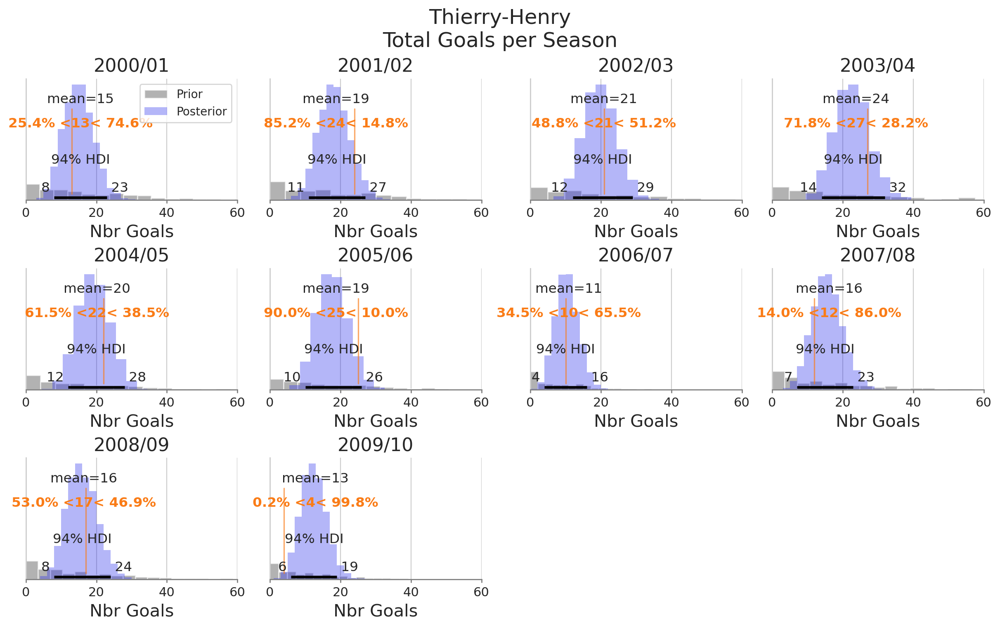

In [54]:
goals_prior = (
    az.extract(idata.prior_predictive, var_names="goals_scored")
    .sel(name_player=PLAYER)
    .groupby("season")
    .sum("obs_id")
)
goals_post = (
    idata.posterior_predictive["goals_scored"]
    .sel(name_player=PLAYER)
    .groupby("season")
    .sum("obs_id")
)
empirics = (
    idata.observed_data.sel(name_player=PLAYER)["goals_scored"]
    .to_pandas()
    .reset_index(name="goals")
    .groupby("season")
    .sum()["goals"]
)

unique_seasons = np.unique(goals_prior.season)
num_seasons = len(unique_seasons)

cols = 4
rows = (num_seasons + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(12, 2.5 * rows), layout="constrained")
axes = axes.flatten()

for season, (i, ax) in zip(unique_seasons, enumerate(axes)):
    ax.hist(
        goals_prior.sel(season=season),
        color="grey",
        ec="white",
        bins=20,
        alpha=0.6,
        label="Prior",
    )
    az.plot_posterior(
        goals_post.sel(season=season),
        label="Posterior",
        ax=ax,
        ref_val=empirics[season],
        textsize=11,
    )
    ax.set(xlabel="Nbr Goals", yticklabels="", title=f"{season}", xlim=[0, 60])
    ax.set_yticks([])
    sns.despine()
    if i == 0:
        ax.legend(fontsize=10, frameon=True)

# remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle(f"{PLAYER.title()}\nTotal Goals per Season", fontsize=18);

### Goal Probabilities per Season

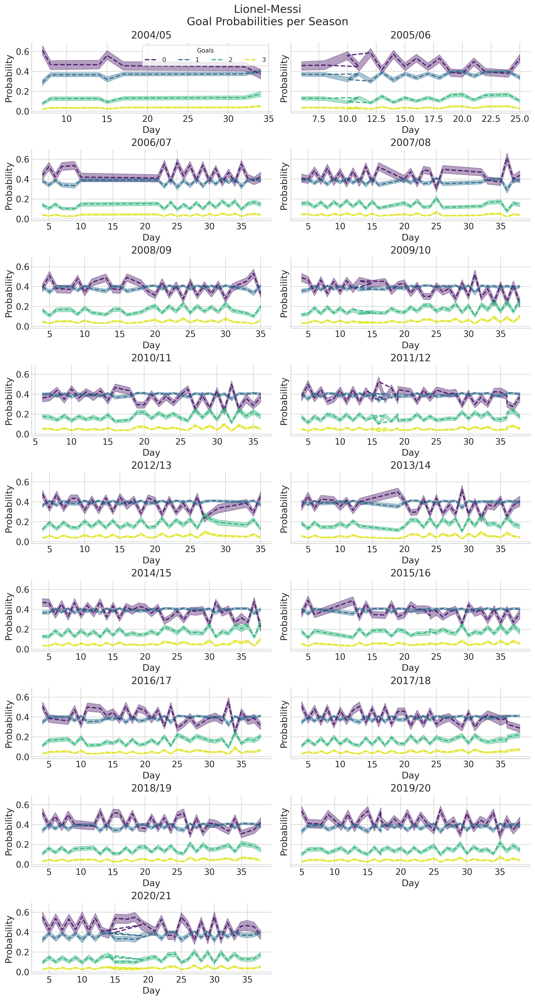

In [56]:
PLAYER = "lionel-messi"
player_probs_post = implied_probs_post.sel(name_player=PLAYER)
colors = plt.cm.viridis(np.linspace(0.05, 0.95, len(coords["event"])))

cols = 2
unique_seasons = np.unique(player_probs_post.season)
num_seasons = len(unique_seasons)
rows = (num_seasons + cols - 1) // cols

fig, axes = plt.subplots(
    rows, cols, figsize=(12, 2.5 * rows), layout="constrained", sharey=True
)
axes = axes.flatten()

for season, (i, ax) in zip(unique_seasons, enumerate(axes)):
    dates = player_probs_post.sel(season=season)["gameday"]
    y_plot = player_probs_post.sel(season=season)

    for event in player_probs_post.event.to_numpy():
        az.plot_hdi(
            x=dates,
            y=y_plot.sel(event=event),
            hdi_prob=0.75,
            color=colors[event],
            fill_kwargs={"alpha": 0.4},
            ax=ax,
            smooth=False,
        )
        ax.plot(
            dates,
            y_plot.sel(event=event).mean(("chain", "draw")),
            lw=2,
            ls="--",
            label=f"{event}",
            color=colors[event],
            alpha=0.9,
        )

    ax.set(xlabel="Day", ylabel="Probability", title=f"{season}")
    sns.despine()
    if i == 0:
        ax.legend(fontsize=10, frameon=True, title="Goals", ncols=4)

# remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle(f"{PLAYER.title()}\nGoal Probabilities per Season", fontsize=18);

### Scoring Probabilities

In [121]:
implied_probs_preds = (
    counterfact_preds.predictions["goals_scored_probs"]
    .rename({"goals_scored_probs_dim_2": "obs_id"})
    .assign_coords(mindex_coords)
)

In [122]:
n_seasons = complete_data.groupby(["name_player"])["season"].nunique().sort_values()
probs_preds = az.extract(implied_probs_preds, var_names="goals_scored_probs")
dates = np.unique(probs_preds["season_nbr"].to_numpy())
player_data = (
    complete_data.groupby(["name_player", "season_nbr"])["goal"]
    .value_counts(normalize=True)
    .sort_index()
    .reset_index(level=[1, 2])
)
player_data = player_data[player_data.goal == 1].drop("goal", axis=1)

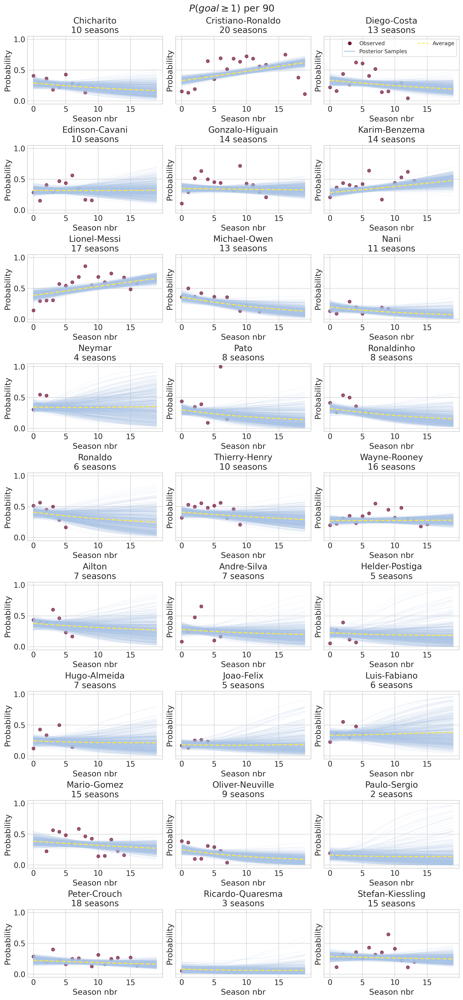

In [125]:
_, axes = plt.subplots(9, 3, figsize=(12, 26), sharey=True, layout="constrained")
axes = axes.flatten()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    player_scoring_prob = 1 - probs_preds.sel(player=player, event=0).groupby(
        "season_nbr"
    ).mean("obs_id")

    ax.plot(
        dates,
        player_scoring_prob.sel(sample=slice(None, None, 10)),
        color="#AAC4E6",
        alpha=0.1,
    )
    ax.plot(dates, player_scoring_prob.mean("sample"), color="#FBE64D", lw=2, ls="--")
    ax.scatter(
        player_data.loc[player, "season_nbr"],
        player_data.loc[player, "proportion"],
        color="#70133A",
        alpha=0.7,
    )

    ax.set(
        title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
        xlabel="Season nbr",
        ylabel="Probability",
    )
    if i == 2:
        handles = [
            Line2D(
                [], [], color="#70133A", marker="o", linestyle="None", label="Observed"
            ),
            Line2D([], [], color="#AAC4E6", label="Posterior Samples"),
            Line2D([], [], color="#FBE64D", ls="--", label="Average"),
        ]
        ax.legend(handles=handles, fontsize=10, frameon=True, ncols=2)

plt.suptitle("$P(goal \\geq 1)$ per 90", fontsize=18);

### Scoring Rates

Compute expected goals per match for each posterior sample (assuming 3+ goals is treated as exactly 3 goals).

In [126]:
expected_goals = (
    (
        1 * implied_probs_preds.sel(event=1)
        + 2 * implied_probs_preds.sel(event=2)
        + 3 * implied_probs_preds.sel(event=3)
    )
    .unstack("obs_id")
    .rename("expected_goals")
)
player_data = complete_data.set_index("name_player")

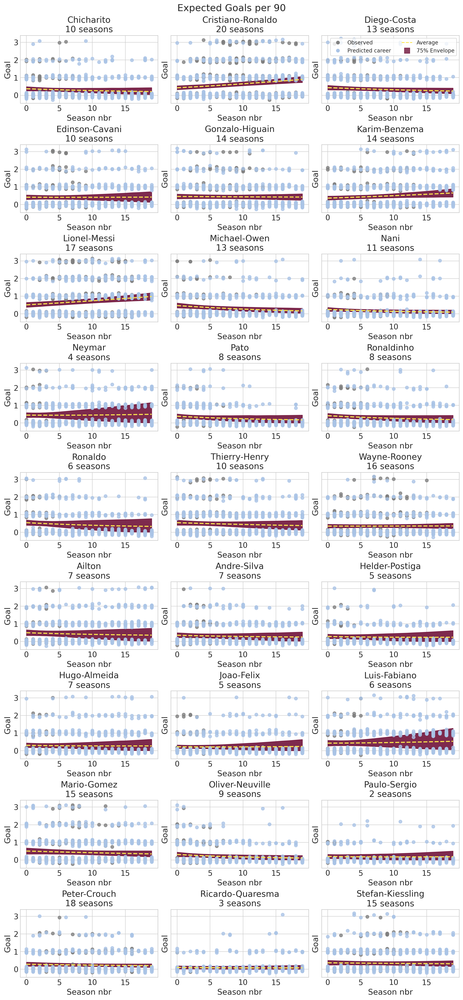

In [128]:
_, axes = plt.subplots(9, 3, figsize=(12, 26), sharey=True, layout="constrained")
axes = axes.flatten()
jitter_strength = 0.07

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    player_scoring_rate = expected_goals.sel(player=player)
    player_preds = az.extract(counterfact_preds.predictions.sel(player=player))[
        "goals_scored"
    ].sel(
        sample=(
            rng.choice(counterfact_preds.predictions.chain),
            rng.choice(counterfact_preds.predictions.draw),
        ),
    )

    ax.plot(
        player_preds["season_nbr"],
        player_preds + rng.normal(0, jitter_strength, player_preds.shape),
        marker="o",
        linestyle="None",
        color="#AAC4E6",
        alpha=0.8,
    )
    az.plot_hdi(
        dates,
        hdi_data=az.hdi(
            player_scoring_rate, input_core_dims=[["chain", "draw", "gameday"]]
        ),
        hdi_prob=0.75,
        ax=ax,
        smooth=False,
        color="#70133A",
        fill_kwargs={"alpha": 0.9},
    )
    ax.plot(
        dates,
        player_scoring_rate.mean(["chain", "draw", "gameday"]),
        color="#FBE64D",
        lw=2,
        ls="--",
    )
    ax.scatter(
        player_data.loc[player, "season_nbr"],
        player_data.loc[player, "goals_cats"]
        + rng.normal(0, jitter_strength, len(player_data.loc[player, "goals_cats"])),
        c="grey",
        alpha=0.8,
    )

    ax.set(
        title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
        xlabel="Season nbr",
        ylabel="Goal",
    )
    if i == 2:
        handles = [
            Line2D(
                [], [], color="grey", marker="o", linestyle="None", label="Observed"
            ),
            Line2D(
                [],
                [],
                color="#AAC4E6",
                marker="o",
                linestyle="None",
                label="Predicted career",
            ),
            Line2D([], [], color="#FBE64D", ls="--", label="Average"),
            Line2D(
                [],
                [],
                color="#70133A",
                alpha=0.8,
                marker="s",
                markersize=10,
                linestyle="None",
                label="75% Envelope",
            ),
        ]
        ax.legend(handles=handles, fontsize=10, frameon=True, ncols=2)

plt.suptitle("Expected Goals per 90", fontsize=18);